### __EFT BOSS WC prior - $p_k$ with $4$ sky-cuts__
Comparison between samples generated with or without the BBN constraint on $\omega_b$.
- `<distribution>1` : BOSS + BBN prior,
- `<distribution>2` : BOSS without BBN prior.

In [32]:
# Import modules and set up plotting
from python_scripts.support import *
%matplotlib inline
# Do not set 'svg' for HTML/PDF exporting
%config InlineBackend.figure_format = 'svg'

matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'

# Define chain folder
chain_dir = os.path.join(os.getcwd(), 'chains/')

__1. Loading the data__

In [33]:
# First distributions: BOSS + BBN Prior
posterior1 = loadMCSamples(file_root=chain_dir+'eftboss_wc_std/posterior', settings={'ignore_rows':0.})
posterior1.name_tag = 'BOSS + BBN'
prior1 = loadMCSamples(file_root=chain_dir+'eftboss_wc_std/prior', settings={'ignore_rows':0.})
prior1.name_tag = 'BOSS + BBN Prior'
# Get the parameter limits
param_limits1 = pd.read_csv(chain_dir+'eftboss_wc_std/param_limits.csv', index_col=0)
# Convert to dictionary
param_limits1 = param_limits1.to_dict()
for key in param_limits1.keys():
    param_limits1[key] = (param_limits1[key][0], param_limits1[key][1])

# Second distributions: BOSS
posterior2 = loadMCSamples(file_root=chain_dir+'eftboss_wc_nobbn/posterior', settings={'ignore_rows':0.})
posterior2.name_tag = 'BOSS'
prior2 = loadMCSamples(file_root=chain_dir+'eftboss_wc_nobbn/prior', settings={'ignore_rows':0.})
prior2.name_tag = 'BOSS Prior'
# Get the parameter limits
param_limits2 = pd.read_csv(chain_dir+'eftboss_wc_nobbn/param_limits.csv', index_col=0)
# Convert to dictionary
param_limits2 = param_limits2.to_dict()
for key in param_limits2.keys():
    param_limits2[key] = (param_limits2[key][0], param_limits2[key][1])

# Define the cosmological and nuisance parameter names and labels
params = posterior1.getParamNames().list()
labels = posterior1.getLatex()[0]
# Exclude A_s from the cosmological parameter list to avoid degeneracy with sigma_8
# Exclude Omega_m from the cosmological parameter list to avoid degeneracy with omega_cdm, 
# omega_b and h
params = [param for param in params if ('A' not in param) and ('Omega' not in param)]
labels = [label for label in labels if ('A' not in label) and ('Omega' not in label)]
# Define the nuisance parameter names and labels
nuisance_params = params[4:12]
nuisance_labels = labels[4:12]
# Define the cosmological parameter names and labels
cosmo_params = [param for param in params if param not in nuisance_params]
cosmo_labels = [label for label in labels if label not in nuisance_labels]

__2. Transforming to logarithmic scale__

In [34]:
# Parameters to be transformed to logarithmic scale, excluding A_s
params_tolog = [param for param in cosmo_params if param != 'ln10^{10}A_s']
# Define the labels based on the index of the parameters to be transformed
labels_tolog = [cosmo_labels[cosmo_params.index(param)] for param in params_tolog]

# Transform these parameters to logarithmic scale
for chain in [posterior1, prior1, posterior2, prior2]:
    log_params, log_labels = log_transform(chain, params_tolog, labels_tolog)

__3. CPCA decomposition__

N_eff 	= 3.0865

Improvement factor over the prior in E.U.:
 [6.61 2.66 2.07 0.7  0.32]


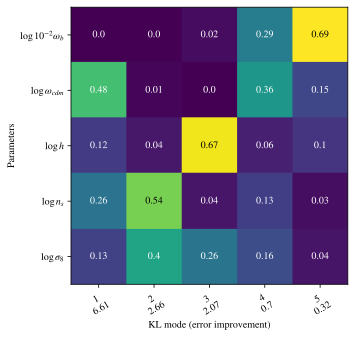

In [35]:
# Plot the fractional CPCA loading matrix on the BOSS + BBN data 
KL_eig1, KL_eigv1, KL_param_names1 = plot_frac_fisher(prior_chain=prior1, posterior_chain=posterior1, 
                                                      params=log_params, labels=log_labels,
                                                      norm=True, figsize=5, print_improvement=True)

N_eff 	= 3.0458

Improvement factor over the prior:
 [49.74  7.68  6.    1.57  0.75]
Discarding error units due to negative values.


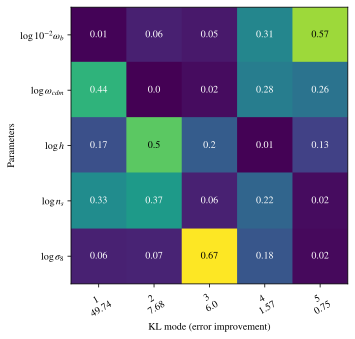

In [36]:
# Do the same on the BOSS data
KL_eig2, KL_eigv2, KL_param_names2 = plot_frac_fisher(prior_chain=prior2, posterior_chain=posterior2, 
                                                      params=log_params, labels=log_labels,
                                                      norm=True, figsize=5, print_improvement=True)

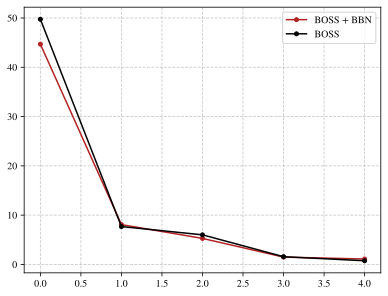

In [37]:
# Scree plot for both datasets: no need to normalize since the eigenvalues are dimensionless
plt.plot(KL_eig1, 'o-', markersize=4, color='firebrick', label='BOSS + BBN')
plt.plot(KL_eig2, 'o-', markersize=4, color='k', label='BOSS')

# Set the legend and the grid
plt.legend()
plt.legend()
plt.grid(linestyle='--', alpha=0.7)
plt.show();

<font size=3>

*__Note__: based on the previous scree plot, we add the first $3$ CPC modes since they preserve the most variance.*

__4.1 Prior Shrinking__

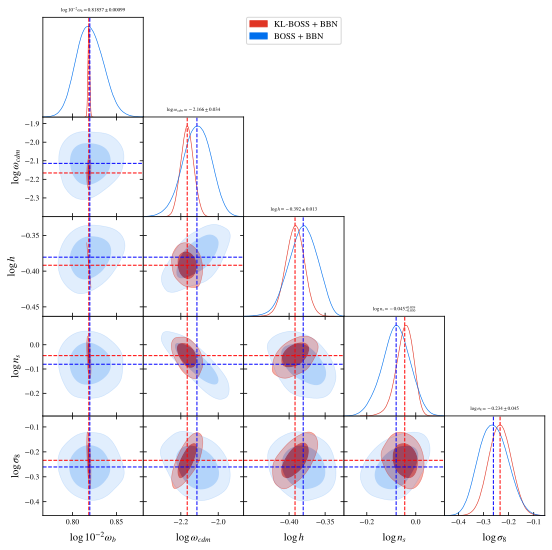

In [38]:
# Push the prior contribution to 0 on the BOSS + BBN data
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
posterior_mean = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
inv_KL_eigv1 = np.linalg.inv(KL_eigv1)
# Only keeping the first 3 modes
inv_KL_eigv1[3:,:] = 0.
# Project the shifted posterior samples on the KL modes
KL_filtered_samples1 = np.dot(np.dot(posterior1.samples[:,idx]-prior_mean, KL_eigv1), inv_KL_eigv1)+prior_mean

# Prior Shrinking - Cosmological Parameters
KL_chain1 = MCSamples(samples=KL_filtered_samples1, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=KL_param_names1, 
                     labels=[name.label for name in posterior1.getParamNames().parsWithNames(KL_param_names1)], 
                     label='KL-BOSS + BBN',
                     settings={'ignore_rows':0.})
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
# The titles refer to the mean values of the KL posterior distributions
g.triangle_plot([KL_chain1, posterior1], params=KL_param_names1, filled=True, title_limit=1)
KL_means1 = KL_chain1.getMeans(pars=[KL_chain1.index[name] for name in KL_param_names1])
means = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
# Display mean indicators
for i in range(len(KL_param_names1)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means1[i], color='red', lw=1., ls='--')
        ax.axvline(means[i], color='blue', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means1[i], color='red', lw=1., ls='--')
        ax.axhline(means[i], color='blue', lw=1., ls='--')

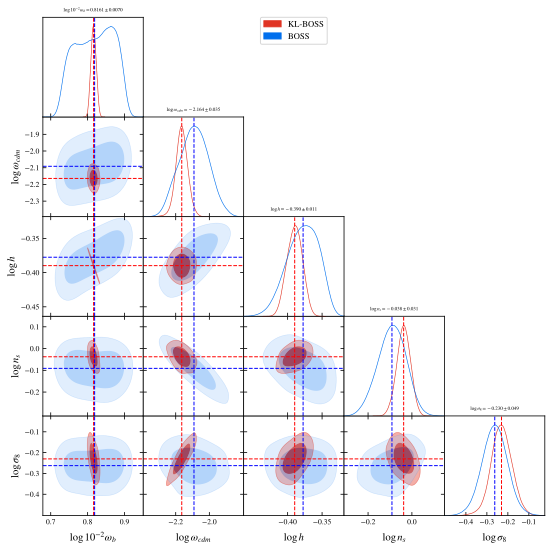

In [39]:
# Push the prior contribution to 0 on the BOSS data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean2 = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
posterior_mean2 = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
inv_KL_eigv2 = np.linalg.inv(KL_eigv2)
# Only keeping the first 3 modes
inv_KL_eigv2[3:,:] = 0.
# Project the shifted posterior samples on the KL modes
KL_filtered_samples2 = np.dot(np.dot(posterior2.samples[:,idx]-prior_mean2, KL_eigv2), inv_KL_eigv2)+prior_mean2

# Prior Shrinking - Cosmological Parameters
KL_chain2 = MCSamples(samples=KL_filtered_samples2, 
                     loglikes=posterior2.loglikes, 
                     weights=posterior2.weights, 
                     names=KL_param_names2, 
                     labels=[name.label for name in posterior2.getParamNames().parsWithNames(KL_param_names2)], 
                     label='KL-BOSS',
                     settings={'ignore_rows':0.})
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
# The titles refer to the mean values of the KL posterior distributions
g.triangle_plot([KL_chain2, posterior2], params=KL_param_names2, filled=True, title_limit=1)
KL_means2 = KL_chain2.getMeans(pars=[KL_chain2.index[name] for name in KL_param_names2])
means2 = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
# Display mean indicators
for i in range(len(KL_param_names2)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means2[i], color='red', lw=1., ls='--')
        ax.axvline(means2[i], color='blue', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means2[i], color='red', lw=1., ls='--')
        ax.axhline(means2[i], color='blue', lw=1., ls='--')

*Note*: despite not including the BBN prior information, $\omega_b$ does not show good overlapping between the 2 distributions, suggesting lack of data constraint.

__4.2 Prior Explosion__

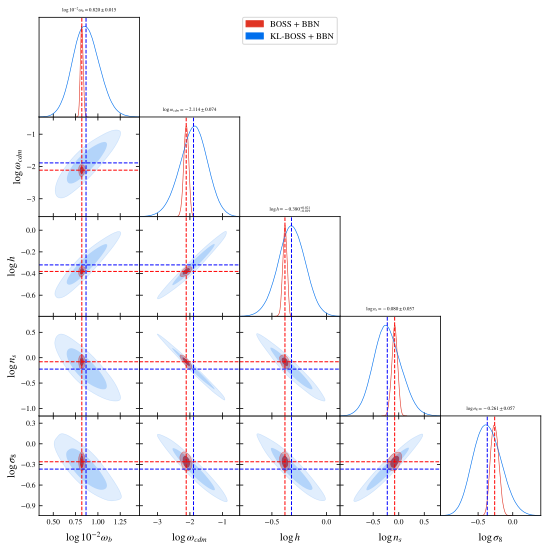

In [40]:
# Push the prior contribution to infinity on the BOSS + BBN data
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
inv_KL_eigv = np.linalg.inv(KL_eigv1)
# Invert the values then send them to 0: this is equivalent to set them to infinity
KL_eig_inv1 = 1./KL_eig1
KL_eig_inv1[:3] = 0.
KL_filtered_samples = np.dot(np.dot(np.diag(1./(1.-KL_eig_inv1)), 
                                    np.dot(KL_eigv1.T, (posterior1.samples[:,idx]).T)).T-np.dot(np.diag(1./(1.-KL_eig_inv1)*KL_eig_inv1), 
                                                                                          np.dot(KL_eigv1.T, prior_mean)), 
                                    inv_KL_eigv)
# Define the new chain
KL_chain_exp1 = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=KL_param_names1, 
                     labels=[name.label for name in posterior1.getParamNames().parsWithNames(KL_param_names1)], 
                     label='KL-BOSS + BBN',
                     settings={'ignore_rows':0.})

# Plot the cosmological parameters
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
g.triangle_plot([posterior1, KL_chain_exp1], params=KL_param_names1, filled=True, title_limit=1);
KL_means = KL_chain_exp1.getMeans(pars=[KL_chain_exp1.index[name] for name in KL_param_names1])
means = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
# Display mean indicators
for i in range(len(KL_param_names1)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axvline(means[i], color='red', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axhline(means[i], color='red', lw=1., ls='--')

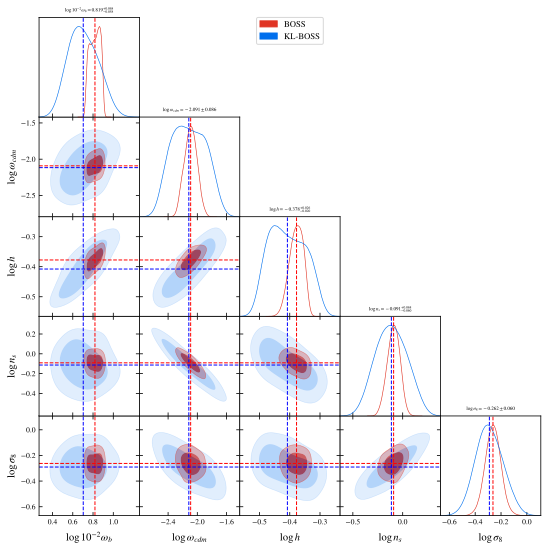

In [41]:
# Push the prior contribution to infinity on the BOSS data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
inv_KL_eigv = np.linalg.inv(KL_eigv2)
# Invert the values then send them to 0: this is equivalent to set them to infinity
KL_eig_inv2 = 1./KL_eig2
KL_eig_inv2[:3] = 0.
KL_filtered_samples = np.dot(np.dot(np.diag(1./(1.-KL_eig_inv2)), 
                                    np.dot(KL_eigv2.T, (posterior2.samples[:,idx]).T)).T-np.dot(np.diag(1./(1.-KL_eig_inv2)*KL_eig_inv2), 
                                                                                          np.dot(KL_eigv2.T, prior_mean)), 
                                    inv_KL_eigv)
# Define the new chain
KL_chain_exp2 = MCSamples(samples=KL_filtered_samples,
                        loglikes=posterior2.loglikes, 
                        weights=posterior2.weights, 
                        names=KL_param_names2, 
                        labels=[name.label for name in posterior2.getParamNames().parsWithNames(KL_param_names2)], 
                        label='KL-BOSS',
                        settings={'ignore_rows':0.})
# Plot the cosmological parameters
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
g.triangle_plot([posterior2, KL_chain_exp2], params=KL_param_names2, filled=True, title_limit=1);
KL_means = KL_chain_exp2.getMeans(pars=[KL_chain_exp2.index[name] for name in KL_param_names2])
means = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
# Display mean indicators
for i in range(len(KL_param_names2)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axvline(means[i], color='red', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axhline(means[i], color='red', lw=1., ls='--')

*Note*: the prior explosion highlights the difference between the 2 datasets: as expected, including the BBN prior brings more external information and the parameters are less data-constrained. In fact the original BBN-free posteriors look quite similar to the new KL-projected ones, while the KL-projected BBN posteriors look much wider than the original ones.

__4.3 Prior and posterior comparison__\
Here we project the posterior and prior distributions on the KL modes (without removing or exploding the prior contribution): higher similarity between the two distributions means higher prior information level.

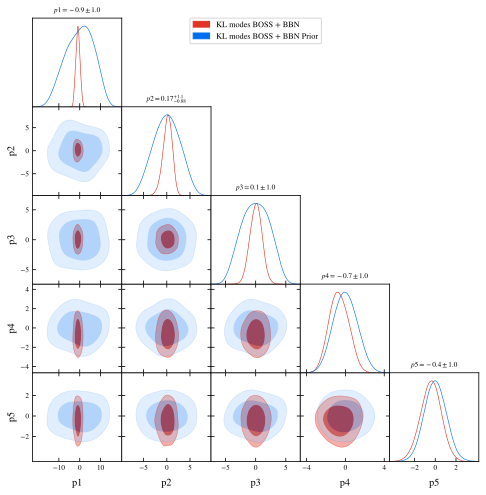

In [42]:
# KL decomposition on the posterior
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
temp_names = [f'p{str(i+1)}' for i in range(len(KL_param_names1))]
# Project the shifted posterior samples on the KL modes
KL_filtered_samples = np.dot(posterior1.samples[:,idx] - prior_mean, KL_eigv1)
KL_chain = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=temp_names, 
                     label='KL modes BOSS + BBN')
# KL decomposition on the prior
idx = [prior1.index[name] for name in KL_param_names1]
# Project the shifted prior samples on the KL modes
KL_filtered_prior_samples = np.dot(prior1.samples[:,idx] - prior_mean, KL_eigv1)
KL_prior_chain = MCSamples(samples=KL_filtered_prior_samples, 
                     loglikes=prior1.loglikes, 
                     weights=prior1.weights, 
                     names=temp_names, 
                     label='KL modes BOSS + BBN Prior')
# Plot the KL modes
g = plots.get_subplot_plotter(width_inch=8)
g.settings.alpha_filled_add = 0.3
g.triangle_plot([KL_chain, KL_prior_chain], params=temp_names, 
                filled=True, title_limit=1);

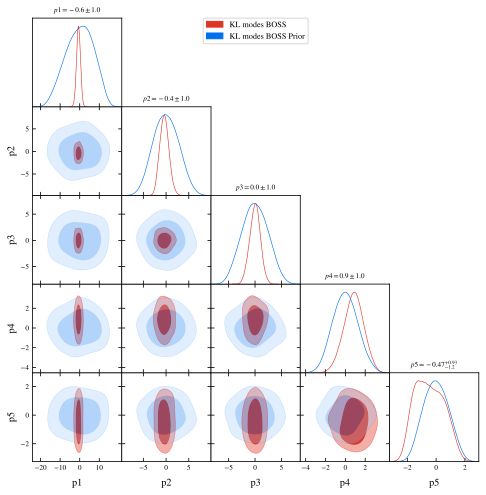

In [43]:
# Repeat the process for the BOSS data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
temp_names = [f'p{str(i+1)}' for i in range(len(KL_param_names2))]
# Project the shifted posterior samples on the KL modes
KL_filtered_samples = np.dot(posterior2.samples[:,idx] - prior_mean, KL_eigv2)
KL_chain = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior2.loglikes, 
                     weights=posterior2.weights, 
                     names=temp_names, 
                     label='KL modes BOSS')
# KL decomposition on the prior
idx = [prior2.index[name] for name in KL_param_names2]
# Project the shifted prior samples on the KL modes
KL_filtered_prior_samples = np.dot(prior2.samples[:,idx] - prior_mean, KL_eigv2)
KL_prior_chain = MCSamples(samples=KL_filtered_prior_samples, 
                     loglikes=prior2.loglikes, 
                     weights=prior2.weights, 
                     names=temp_names, 
                     label='KL modes BOSS Prior')
# Plot the KL modes
g = plots.get_subplot_plotter(width_inch=8)
g.settings.alpha_filled_add = 0.3
g.triangle_plot([KL_chain, KL_prior_chain], params=temp_names, 
                filled=True, title_limit=1);

The curves get more and more overlapping as the mode's variance contribution decreases.\
This projection produces uncorrelated distributions, with unit variance.

__5. Best-constrained parameters__

In [44]:
from tensiometer_dev.tensiometer import *
# Print CPC parameter combinations
dict1 = gaussian_tension.linear_CPCA_chains(prior1, posterior1, param_names=log_params)
dict2 = gaussian_tension.linear_CPCA_chains(prior2, posterior2, param_names=log_params)

# Define the start and end string delimiting the text to be printed
start = 'CPC parameter combinations:'
end = 'CPC modes parameters correlations'
s = gaussian_tension.print_CPCA_results(dict1)
print('BOSS + BBN CPC Parameter Combinations', end=' ')
print(s[s.find(start)+len(start):s.rfind(end)])
s = gaussian_tension.print_CPCA_results(dict2)
print('\n\nBOSS CPC Parameter Combinations', end=' ')
print(s[s.find(start)+len(start):s.rfind(end)])

BOSS + BBN CPC Parameter Combinations 
   1 :   43.682 (   660.9 %)
      +1.00*(\log \omega{}_{cdm } +2.11) -1.23*(\log h +0.38) +0.93*(\log n_{s } +0.08) +0.20*(\log \sigma_8 +0.26) = 0 +- 0.038 (post) / 0.26 (prior)
   2 :    7.078 (   266.1 %)
      +1.00*(\log n_{s } +0.08) -0.66*(\log \sigma_8 +0.26) = 0 +- 0.045 (post) / 0.13 (prior)
   3 :    4.280 (   206.9 %)
      +1.00*(\log h +0.38) +0.17*(\log \sigma_8 +0.26) = 0 +- 0.018 (post) / 0.042 (prior)
   4 :    0.492 (    70.2 %)
      -6.31*(\log 10^{-2}\omega{}_{b } -0.82) +1.00*(\log \omega{}_{cdm } +2.11) -0.30*(\log n_{s } +0.08) -1.02*(\log \sigma_8 +0.26) = 0 +- 0.17 (post) / 0.2 (prior)
   5 :    0.101 (    31.9 %)
      +1.00*(\log 10^{-2}\omega{}_{b } -0.82) +0.05*(\log \omega{}_{cdm } +2.11) +0.22*(\log h +0.38) = 0 +- 0.019 (post) / 0.02 (prior)




BOSS CPC Parameter Combinations 
   1 :   48.738 (   698.1 %)
      +1.00*(\log \omega{}_{cdm } +2.09) -1.42*(\log h +0.38) +1.02*(\log n_{s } +0.09) = 0 +- 0.034 (post) 

In [45]:
# Use the first 3 modes derived from each dataset to define new parameters
temp_chain1 = posterior1.copy()
temp_chain2 = posterior2.copy()
p1 = temp_chain1.getParams()
p2 = temp_chain2.getParams()

# Add the new parameters to the first chain
temp_chain1.addDerived(p1.omega_cdm * p1.h**(-1.23) * p1.n_s**0.93 * p1.sigma8**0.20,
                        name='p1', label='p_1 = \\frac{\omega_{cdm} n_s^{0.93} \sigma_8^{0.20}}{h^{1.23}}')
temp_chain1.addDerived(p1.n_s**1.00 * p1.sigma8**(-0.66),
                        name='p2', label='p_2 = \\frac{n_s}{\sigma_8^{0.66}}')
temp_chain1.addDerived(p1.h**1.00 * p1.sigma8**0.17,
                        name='p3', label='p_3 = h \sigma_8^{0.17}')

# Add the new parameters to the second chain
temp_chain2.addDerived(p2.omega_cdm**1.00 * p2.h**(-1.42) * p2.n_s**1.02,
                        name='p1', label='p_1 = \\frac{\omega_{cdm} n_s^{1.02}}{ h^{1.42}}')
temp_chain2.addDerived(p2.h**1.00 * p2.n_s**0.31,
                        name='p2', label='p_2 = h n_s^{0.31}')
temp_chain2.addDerived(p2.h**2.27 * p2.sigma8**1.00,
                        name='p3', label='p_3 = h^{2.27} \sigma_8')

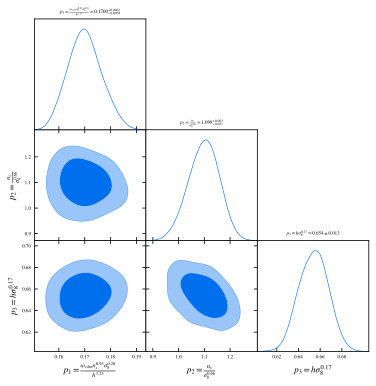

In [46]:
# Plot the new parameters on the first chain
g = plots.get_subplot_plotter(width_inch=6)
g.settings.alpha_filled_add = 0.3
g.settings.axes_labelsize = 12
g.settings.axes_fontsize = 1
g.triangle_plot([temp_chain1], params=['p1', 'p2', 'p3'], filled=True, title_limit=1);

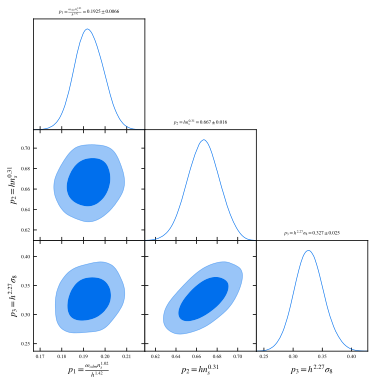

In [47]:
# Plot the new parameters on the second chain
g = plots.get_subplot_plotter(width_inch=6)
g.settings.alpha_filled_add = 0.3
g.settings.axes_labelsize = 12
g.settings.axes_fontsize = 1
g.triangle_plot([temp_chain2], params=['p1', 'p2', 'p3'], filled=True, title_limit=1);

*Note*: these new distributions look fairly Gaussian. Notice how none of them includes $\omega_b$.

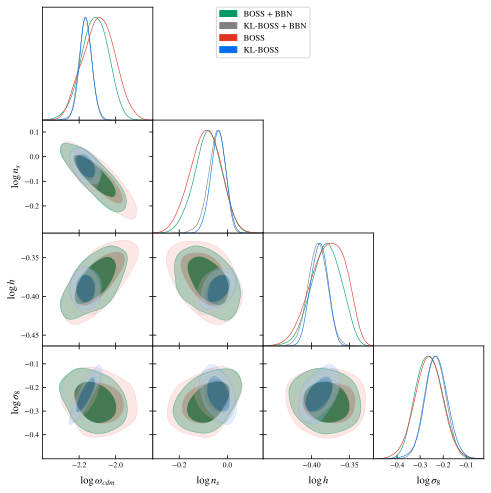

In [48]:
# Graphic evaluation
g = plots.get_subplot_plotter(width_inch=7)
g.settings.alpha_filled_add = 0.3
# Compare the KL-filtered chains with the original ones, using null priors
g.triangle_plot([posterior1, KL_chain1, posterior2, KL_chain2], 
                params=['log_omega_cdm', 'log_n_s', 'log_h', 'log_sigma8'], 
                filled=True)

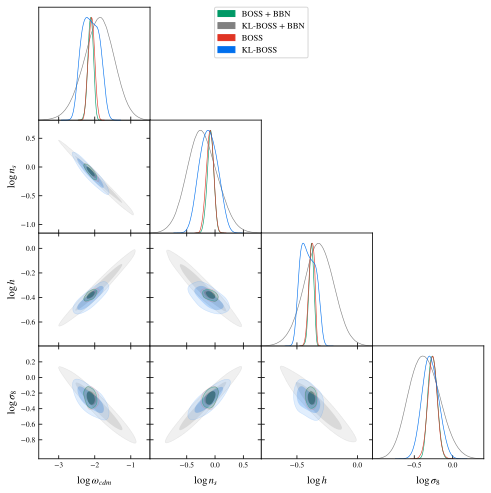

In [49]:
# Graphic evaluation
g = plots.get_subplot_plotter(width_inch=7)
g.settings.alpha_filled_add = 0.3
# Compare the KL-filtered chains with the original ones, using exploded priors
g.triangle_plot([posterior1, KL_chain_exp1, posterior2, KL_chain_exp2], 
                params=['log_omega_cdm', 'log_n_s', 'log_h', 'log_sigma8'], 
                filled=True)

Once again, we show here that the *exploded* KL-BOSS + BBN distribution is definitely wider than the other ones, suggesting a higher impact of the prior distribution. The elongated shape on the 2D planes suggests the existence of directions of degeneration, captured by the previously defined modes.\
For example, note the distribution on the $n_s - \omega_{cdm}$ plane: indeed, the first mode of both datasets depends approximately linearly on both parameters. 

__6. Tension Estimates__

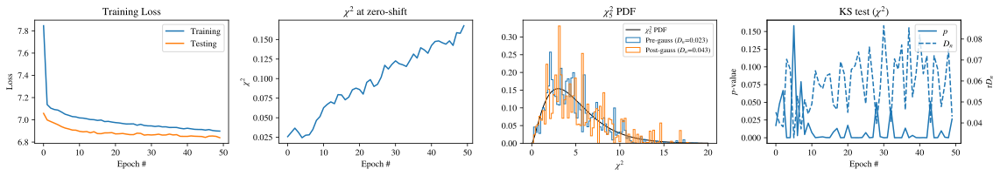

256/256 [==============================] - 8s 32ms/step - loss: 6.8987 - val_loss: 6.8393 - shift0_chi2: 0.1676 - shift0_pval: 5.7651e-04 - shift0_nsigma: 7.2254e-04 - chi2Z_ks: 0.0430 - chi2Z_ks_p: 0.0264 - lr: 0.0010
Training completed.
Time taken to train the model: 445.3807351589203 seconds


In [50]:
from python_scripts.flow import *
# Create a DiffFlow object
flow = DiffFlow(posterior1, posterior2, params=cosmo_params, labels=cosmo_labels)
# Build the difference chains
flow.build_diff()

# Train the Normalizing Flow model
# Print the time taken to train the model
import time
start = time.time()
flow.train(eta=0.001, epochs=50, batch_size=1024, steps_per_epoch=256)
end = time.time()
print('Time taken to train the model: {} seconds'.format(end-start))

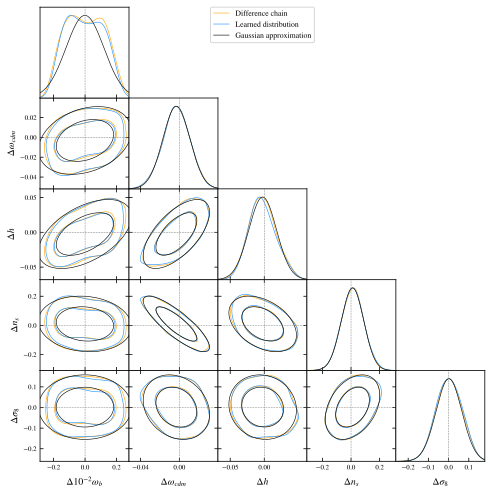

In [51]:
# Plot the learned and the approximated distributions, as well as the difference chain
flow.plot_distributions()

In [52]:
# Print the shift estimate, also in number of sigmas
flow.estimate_shift()

Considering ['delta_omega_b', 'delta_omega_cdm', 'delta_h', 'delta_n_s', 'delta_sigma8'] parameters...
Shift probability = 0.01605 + 0.00135 - 0.00125
          n_sigma = 0.020


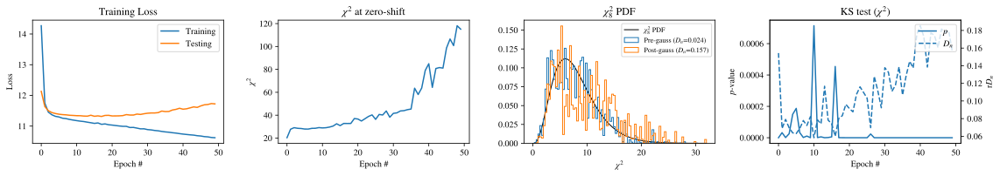

256/256 [==============================] - 17s 65ms/step - loss: 10.6210 - val_loss: 11.7234 - shift0_chi2: 115.1182 - shift0_pval: 1.0000 - shift0_nsigma: inf - chi2Z_ks: 0.1568 - chi2Z_ks_p: 2.2100e-25 - lr: 0.0010
Training completed.
Time taken to train the model: 916.6122114658356 seconds


In [53]:
# Use the EFT parameters to train the model
from python_scripts.flow import *
# Create a DiffFlow object
flow = DiffFlow(posterior1, posterior2, params=nuisance_params, labels=nuisance_labels,)
# Build the difference chains
flow.build_diff()

# Train the Normalizing Flow model
# Print the time taken to train the model
import time
start = time.time()
flow.train(eta=0.001, epochs=50, batch_size=1024, steps_per_epoch=256)
end = time.time()
print('Time taken to train the model: {} seconds'.format(end-start))

In [54]:
# Plot the learned and the approximated distributions, as well as the difference chain
flow.plot_distributions()

In [55]:
# Print the shift estimate, also in number of sigmas
flow.estimate_shift()

Considering ['delta_b1_hN', 'delta_c2_hN', 'delta_b1_hS', 'delta_c2_hS', 'delta_b1_lN', 'delta_c2_lN', 'delta_b1_lS', 'delta_c2_lS'] parameters...
Shift probability = 1.00000 + nan - 0.00018
          n_sigma = inf


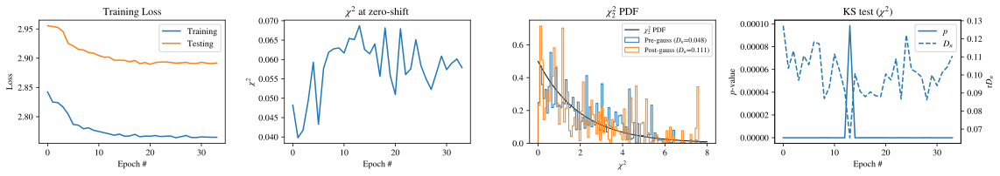

256/256 [==============================] - 4s 16ms/step - loss: 2.7648 - val_loss: 2.8918 - shift0_chi2: 0.0579 - shift0_pval: 0.0285 - shift0_nsigma: 0.0358 - chi2Z_ks: 0.1106 - chi2Z_ks_p: 8.3810e-13 - lr: 2.5000e-04
Epoch 34: early stopping
Training completed.
Time taken to train the model: 107.1195740699768 seconds


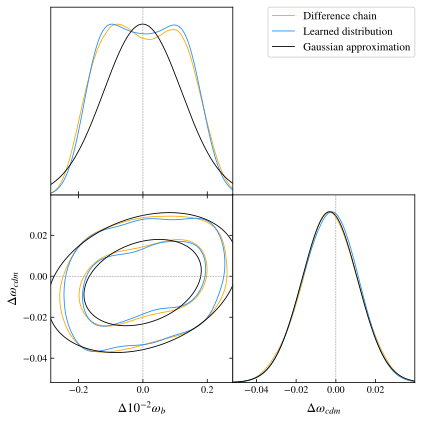

In [56]:
from python_scripts.flow import *
# Create a DiffFlow object
flow = DiffFlow(posterior1, posterior2, params=cosmo_params[:2], labels=cosmo_labels[:2])
# Build the difference chains
flow.build_diff()

# Train the Normalizing Flow model
# Print the time taken to train the model
import time
start = time.time()
flow.train(eta=0.001, epochs=50, batch_size=1024, steps_per_epoch=256)
end = time.time()
print('Time taken to train the model: {} seconds'.format(end-start))

flow.plot_distributions()